In [ ]:
import os

In [ ]:
import glob

In [ ]:
from IPython.display import Image, display

In [ ]:
!nvidia-smi

Mon Apr 22 08:04:22 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
HOME = os.getcwd()

In [ ]:
print(HOME)

/content


In [ ]:
!pip install ultralytics

In [ ]:
import ultralytics

In [ ]:
ultralytics.checks()

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.3/78.2 GB disk)


In [ ]:
!mkdir {HOME}/datasets

mkdir: cannot create directory ‘/content/datasets’: File exists


In [ ]:
%cd {HOME}/datasets

/content/datasets


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="cF3eJWLEf92Pxj2p6MO1")
project = rf.workspace("deejay").project("video_pothole_segmentation")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.2, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Video_Pothole_Segmentation-1 in yolov8:: 100%|██████████| 4904/4904 [00:01<00:00, 4291.53it/s]


In [ ]:
!pip install fastapi kaleido python_multipart uvicorn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.9/91.9 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 9.1 MB/s eta 0:00:00


In [ ]:
%cd {HOME}

/content


In [ ]:
%cd {dataset.location}

/content/datasets/Video_Pothole_Segmentation-1


In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8m.pt data=/content/datasets/Video_Pothole_Segmentation-1/data.yaml epochs=70 imgsz=640


/content
100% 49.7M/49.7M [00:00<00:00, 283MB/s]
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/datasets/Video_Pothole_Segmentation-1/data.yaml, epochs=70, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=Fa

In [ ]:
!ls {HOME}//runs/detect/train

args.yaml					    R_curve.png		 val_batch0_labels.jpg
confusion_matrix_normalized.png			    results.csv		 val_batch0_pred.jpg
confusion_matrix.png				    results.png		 val_batch1_labels.jpg
events.out.tfevents.1713773256.0a73042dc93b.2040.0  train_batch0.jpg	 val_batch1_pred.jpg
F1_curve.png					    train_batch1.jpg	 val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch2.jpg	 val_batch2_pred.jpg
labels.jpg					    train_batch5520.jpg  weights
P_curve.png					    train_batch5521.jpg
PR_curve.png					    train_batch5522.jpg


/content


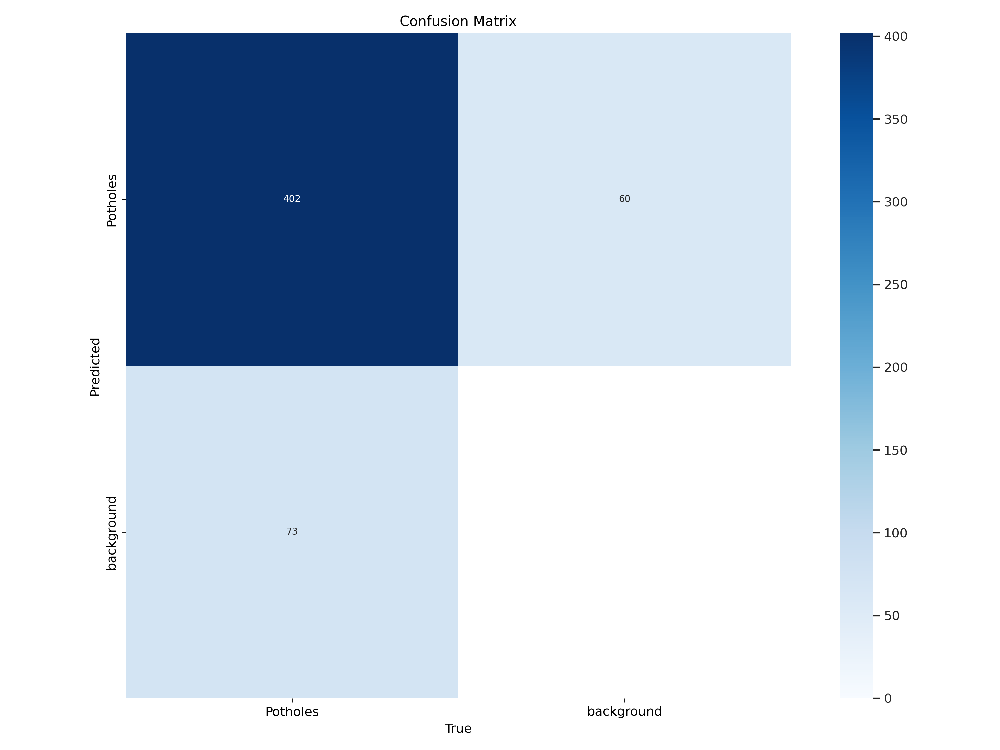

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train/confusion_matrix.png', width = 900)

/content


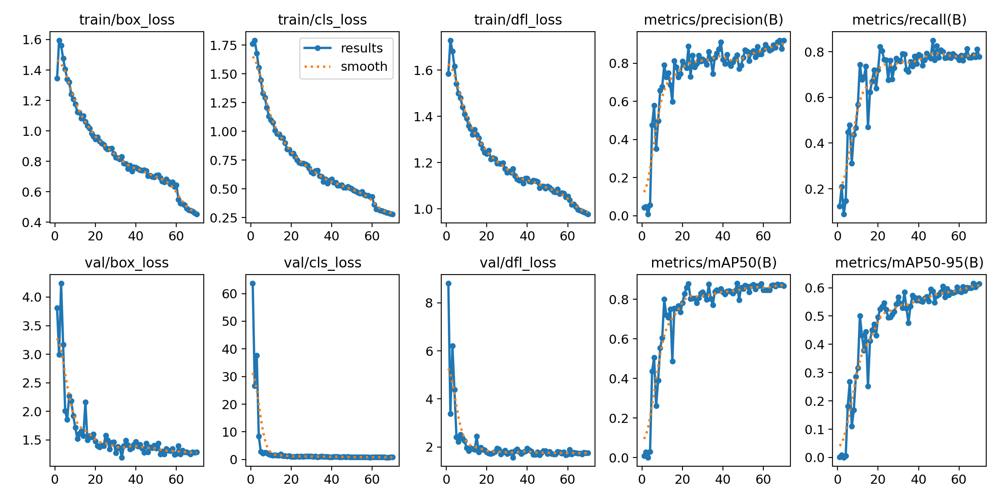

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train/results.png', width = 600)

/content


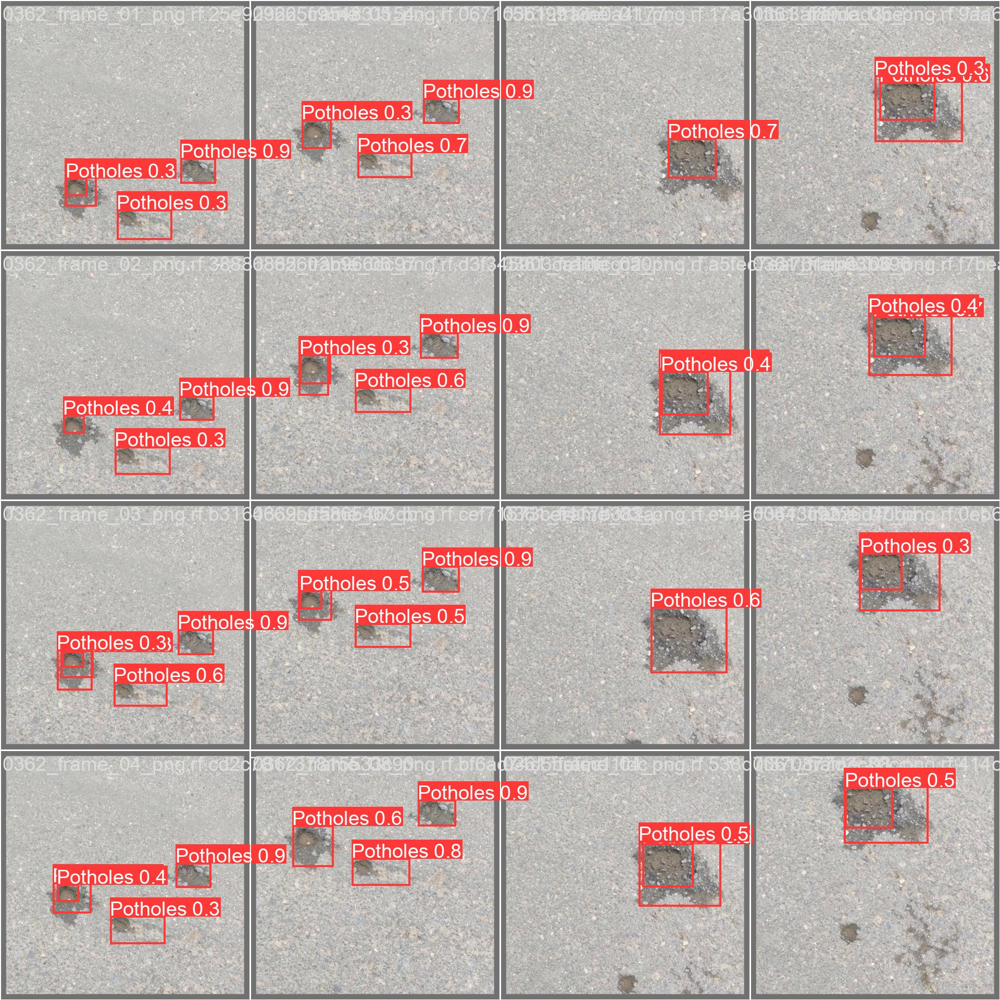

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width = 600)

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data=/content/datasets/Video_Pothole_Segmentation-1/data.yaml

/content
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/datasets/Video_Pothole_Segmentation-1/valid/labels.cache... 484 images, 39 backgrounds, 0 corrupt: 100% 484/484 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/datasets/Video_Pothole_Segmentation-1/valid/images/0267_frame_02_png.rf.6f1d13d68952d21dc3f998da7571062d.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 31/31 [00:16<00:00,  1.90it/s]
                   all        484        475      0.916      0.785      0.877      0.616
Speed: 0.9ms preprocess, 20.7ms inference, 0.0ms loss, 5.0ms postprocess per image
Results saved to runs/detect/val2
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source=/content/datasets/Video_Pothole_Segmentation-1/test/images

/content
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

image 1/492 /content/datasets/Video_Pothole_Segmentation-1/test/images/0081_frame_01_png.rf.094c66eb0ba333e5024e7261c0212fcb.jpg: 640x640 1 Potholes, 37.1ms
image 2/492 /content/datasets/Video_Pothole_Segmentation-1/test/images/0081_frame_02_png.rf.70746cb908fbbdf19fb8136a15cc7f74.jpg: 640x640 2 Potholess, 37.1ms
image 3/492 /content/datasets/Video_Pothole_Segmentation-1/test/images/0081_frame_03_png.rf.adb0445428c9c795361bb1278a63054d.jpg: 640x640 1 Potholes, 37.0ms
image 4/492 /content/datasets/Video_Pothole_Segmentation-1/test/images/0081_frame_04_png.rf.38c3b8cbdf3c816bec1e1fc3617b50b7.jpg: 640x640 1 Potholes, 37.1ms
image 5/492 /content/datasets/Video_Pothole_Segmentation-1/test/images/0081_frame_05_png.rf.9fd5971dbe84d96d5f7c478abb8af257.jpg: 640x640 1 Potholes, 37.1ms
image 6/492 /content/datasets/Video_P

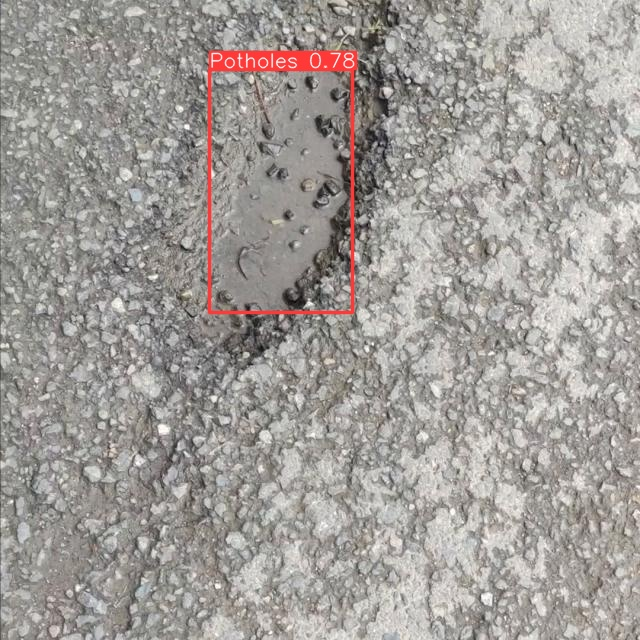

In [ ]:
Image('/content/runs/detect/predict/0081_frame_06_png.rf.89fea5ad94477c515998599dfeff435c.jpg')


In [ ]:
import shutil

# Path to the directory you want to zip
directory_to_zip = '/content/runs'

# Path to the output zip file
output_zip_file = '/content/runs.zip'

# Create a zip archive of the directory
shutil.make_archive(output_zip_file.replace('.zip', ''), 'zip', directory_to_zip)

'/content/runs.zip'

In [ ]:
%cd {HOME}

!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source='/content/demo.mp4'

/content
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (frame 1/692) /content/demo.mp4: 384x640 1 Potholes, 88.4ms
video 1/1 (frame 2/692) /content/demo.mp4: 384x640 1 Potholes, 25.1ms
video 1/1 (frame 3/692) /content/demo.mp4: 384x640 1 Potholes, 25.1ms
video 1/1 (frame 4/692) /content/demo.mp4: 384x640 1 Potholes, 25.1ms
video 1/1 (frame 5/692) /content/demo.mp4: 384x640 (no detections), 25.1ms
video 1/1 (frame 6/692) /content/demo.mp4: 384x640 (no detections), 25.1ms
video 1/1 (frame 7/692) /content/demo.mp4: 384x640 (no detections), 22.8ms
video 1/1 (frame 8/692) /content/demo.mp4: 384x640 (no detections), 18.5ms
video 1/1 (frame 9/692) /content/demo.mp4: 384x640 (no detections), 18.5ms
video 1/1 (frame 10/692) /content/demo.mp4: 384x640 1 Potholes, 18.4ms
video 1/1 (frame 11/692) /content/demo.mp4: 384x640 1 Potholes, 18.5ms
video 1/1 (frame 12/692) /

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict2/demo.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""<video width="640" height="480" controls>
    <source src="{data_url}" type="video/mp4">
</video>""")